## Setup

In [1]:
# Data manipulation
import numpy as np
import pandas as pd

# Data visualization
from plotly import express as xp
from plotly import graph_objects as go

### Pandas Options

In [2]:
# Suppress the "SettingWithCopy" warnings.
pd.options.mode.chained_assignment = None

### Plotly Theming

In [3]:
def spacify(components, attribute):
    """
    Add spaces to the specified attribute of each `Figure` component.
    """
    for component in components:
        try:
            component[attribute] = component[attribute].replace("=", " = ")
        except:
            pass

In [4]:
def _prettify(figure):
    """
    Prettify the `Figure`.
    """
    spacify(figure["data"], "hovertemplate")
    
    for frame in figure["frames"]:
        spacify(frame["data"], "hovertemplate")
    
    for slider in figure["layout"]["sliders"]:
        spacify([slider["currentvalue"]], "prefix")
    
    figure.update_layout(font={"family": "sans", 
                               "size": 14}, 
                         hoverlabel={"bordercolor": "white", 
                                     "font": {"color": "white", 
                                              "family": "sans", 
                                              "size": 12}}, 
                         title={"font": {"size": 20}},
                         template="plotly_white", 
                         width=600,
                         height=400)
    figure.update_traces(opacity=0.6)
    figure.update_xaxes(ticks="outside", 
                        tickcolor="white", 
                        ticklen=10)
    figure.update_yaxes(ticks="outside", 
                        tickcolor="white", 
                        ticklen=10)
    return figure

In [5]:
#  Monkey patch the graph_objects `Figure` class to add custom methods.
go.Figure.prettify = _prettify

## Data

In [6]:
test = pd.read_csv("../data/test.csv")
train = pd.read_csv("../data/train.csv")
spray = pd.read_csv("../data/spray.csv")
weather = pd.read_csv("../data/weather.csv")

In [7]:
print("   Test :", test.shape)
print("  Train :", train.shape)
print("  Spray :", spray.shape)
print("Weather :", weather.shape)

   Test : (116293, 11)
  Train : (10506, 12)
  Spray : (14835, 4)
Weather : (2944, 22)


### Test Traps

In [8]:
test.head()

,Id,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy
0,1,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
1,2,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
2,3,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX PIPIENS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
3,4,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX SALINARIUS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
4,5,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX TERRITANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9


In [9]:
# Drop unnecessary columns.
test.drop(columns=["Address", "Block", "Street", "AddressNumberAndStreet", "AddressAccuracy"], inplace=True)

# Convert the `Date` column to a datetime type.
test["Date"] = pd.to_datetime(test["Date"])

In [10]:
test.head()

,Id,Date,Species,Trap,Latitude,Longitude
0,1,2008-06-11,CULEX PIPIENS/RESTUANS,T002,41.95469,-87.800991
1,2,2008-06-11,CULEX RESTUANS,T002,41.95469,-87.800991
2,3,2008-06-11,CULEX PIPIENS,T002,41.95469,-87.800991
3,4,2008-06-11,CULEX SALINARIUS,T002,41.95469,-87.800991
4,5,2008-06-11,CULEX TERRITANS,T002,41.95469,-87.800991


In [11]:
test.dtypes

Id                    int64
Date         datetime64[ns]
Species              object
Trap                 object
Latitude            float64
Longitude           float64
dtype: object

In [12]:
test.isna().sum()

Id           0
Date         0
Species      0
Trap         0
Latitude     0
Longitude    0
dtype: int64

In [13]:
test.shape

(116293, 6)

### Train Traps

In [14]:
train.head()

,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,NumMosquitos,WnvPresent
0,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0
1,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0
2,2007-05-29,"6200 North Mandell Avenue, Chicago, IL 60646, USA",CULEX RESTUANS,62,N MANDELL AVE,T007,"6200 N MANDELL AVE, Chicago, IL",41.994991,-87.769279,9,1,0
3,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX PIPIENS/RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,1,0
4,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,4,0


In [15]:
# There are duplicated rows in our `train` data.
train.duplicated(subset=train.drop(columns=["NumMosquitos", "WnvPresent"]).columns).sum()

2031

In [16]:
# Remove duplicated rows, keeping only the rows with maximum values.
train = train.groupby(train.drop(columns=["NumMosquitos", "WnvPresent"]).columns.to_list()).max().reset_index()

In [17]:
train.head()

,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,NumMosquitos,WnvPresent
0,2007-05-29,"1100 Roosevelt Road, Chicago, IL 60608, USA",CULEX PIPIENS/RESTUANS,11,W ROOSEVELT,T048,"1100 W ROOSEVELT, Chicago, IL",41.867108,-87.654224,8,1,0
1,2007-05-29,"1100 Roosevelt Road, Chicago, IL 60608, USA",CULEX RESTUANS,11,W ROOSEVELT,T048,"1100 W ROOSEVELT, Chicago, IL",41.867108,-87.654224,8,2,0
2,2007-05-29,"1100 South Peoria Street, Chicago, IL 60608, USA",CULEX RESTUANS,11,S PEORIA ST,T091,"1100 S PEORIA ST, Chicago, IL",41.862292,-87.648860,8,1,0
3,2007-05-29,"1100 West Chicago Avenue, Chicago, IL 60642, USA",CULEX RESTUANS,11,W CHICAGO,T049,"1100 W CHICAGO, Chicago, IL",41.896282,-87.655232,8,1,0
4,2007-05-29,"1500 North Long Avenue, Chicago, IL 60651, USA",CULEX RESTUANS,15,N LONG AVE,T153,"1500 N LONG AVE, Chicago, IL",41.907645,-87.760886,8,1,0


In [18]:
train.shape

(8475, 12)

In [19]:
# Drop unneccessary columns.
train.drop(columns=["Address", "Block", "Street", "AddressNumberAndStreet", "AddressAccuracy"], inplace=True)

# Convert the `Date` column to a datetime object.
train["Date"] = pd.to_datetime(train["Date"])

In [20]:
train.head()

,Date,Species,Trap,Latitude,Longitude,NumMosquitos,WnvPresent
0,2007-05-29,CULEX PIPIENS/RESTUANS,T048,41.867108,-87.654224,1,0
1,2007-05-29,CULEX RESTUANS,T048,41.867108,-87.654224,2,0
2,2007-05-29,CULEX RESTUANS,T091,41.862292,-87.648860,1,0
3,2007-05-29,CULEX RESTUANS,T049,41.896282,-87.655232,1,0
4,2007-05-29,CULEX RESTUANS,T153,41.907645,-87.760886,1,0


In [21]:
train.dtypes

Date            datetime64[ns]
Species                 object
Trap                    object
Latitude               float64
Longitude              float64
NumMosquitos             int64
WnvPresent               int64
dtype: object

In [22]:
train.isna().sum()

Date            0
Species         0
Trap            0
Latitude        0
Longitude       0
NumMosquitos    0
WnvPresent      0
dtype: int64

In [23]:
train.shape

(8475, 7)

### Spray Areas

In [24]:
spray.head()

,Date,Time,Latitude,Longitude
0,2011-08-29,6:56:58 PM,42.391623,-88.089163
1,2011-08-29,6:57:08 PM,42.391348,-88.089163
2,2011-08-29,6:57:18 PM,42.391022,-88.089157
3,2011-08-29,6:57:28 PM,42.390637,-88.089158
4,2011-08-29,6:57:38 PM,42.390410,-88.088858


In [25]:
# Drop duplicated rows, if any.
spray.drop_duplicates(inplace=True)

In [26]:
# Drop unnecessary columns.
spray.drop(columns="Time", inplace=True)

# Convert the `Date` column to a datetime object.
spray["Date"] = pd.to_datetime(spray["Date"])

In [27]:
spray.head()

,Date,Latitude,Longitude
0,2011-08-29,42.391623,-88.089163
1,2011-08-29,42.391348,-88.089163
2,2011-08-29,42.391022,-88.089157
3,2011-08-29,42.390637,-88.089158
4,2011-08-29,42.390410,-88.088858


In [28]:
spray.dtypes

Date         datetime64[ns]
Latitude            float64
Longitude           float64
dtype: object

In [29]:
spray.isna().sum()

Date         0
Latitude     0
Longitude    0
dtype: int64

In [30]:
spray.shape

(14294, 3)

### Weather

In [31]:
weather.head()

,Station,Date,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,...,CodeSum,Depth,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed
0,1,2007-05-01,83,50,67,14,51,56,0,2,...,,0,M,0.0,0.00,29.10,29.82,1.7,27,9.2
1,2,2007-05-01,84,52,68,M,51,57,0,3,...,,M,M,M,0.00,29.18,29.82,2.7,25,9.6
2,1,2007-05-02,59,42,51,-3,42,47,14,0,...,BR,0,M,0.0,0.00,29.38,30.09,13.0,4,13.4
3,2,2007-05-02,60,43,52,M,42,47,13,0,...,BR HZ,M,M,M,0.00,29.44,30.08,13.3,2,13.4
4,1,2007-05-03,66,46,56,2,40,48,9,0,...,,0,M,0.0,0.00,29.39,30.12,11.7,7,11.9


Add the geolocations of the two weather stations.
- Station 1: CHICAGO O'HARE INTERNATIONAL AIRPORT Lat: 41.995 Lon: -87.933 Elev: 662 ft. above sea level
- Station 2: CHICAGO MIDWAY INTL ARPT Lat: 41.786 Lon: -87.752 Elev: 612 ft. above sea level

In [32]:
weather["Latitude"] = weather["Station"].map({1: 41.995, 2: 41.786})
weather["Longitude"] = weather["Station"].map({1: -87.933, 2: -87.752})

In [33]:
weather.head()

,Station,Date,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,...,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed,Latitude,Longitude
0,1,2007-05-01,83,50,67,14,51,56,0,2,...,M,0.0,0.00,29.10,29.82,1.7,27,9.2,41.995,-87.933
1,2,2007-05-01,84,52,68,M,51,57,0,3,...,M,M,0.00,29.18,29.82,2.7,25,9.6,41.786,-87.752
2,1,2007-05-02,59,42,51,-3,42,47,14,0,...,M,0.0,0.00,29.38,30.09,13.0,4,13.4,41.995,-87.933
3,2,2007-05-02,60,43,52,M,42,47,13,0,...,M,M,0.00,29.44,30.08,13.3,2,13.4,41.786,-87.752
4,1,2007-05-03,66,46,56,2,40,48,9,0,...,M,0.0,0.00,29.39,30.12,11.7,7,11.9,41.995,-87.933


## Visualization

In [34]:
def center(series):
    """
    Get the center value (middle between minimum and maximum) of a `Series`.
    """
    return (series.min()+series.max()) / 2

In [35]:
def set_hovertemplate(trace, frame):
    """
    Set the hovertemplate from the specified `Trace` and `Frame`.
    """
    hoverlines = [trace["legendgroup"], 
                  "---",
                  "Latitude = %{lat}", 
                  "Longitude = %{lon}",
                  "<extra></extra>"]
    
    if trace["legendgroup"].startswith("WNV"):
        hoverlines.insert(2, "Species = %{customdata[0]}")
        hoverlines.insert(2, "Mosquitos = %{marker.size}")
    
    if trace["legendgroup"] != "Weather Station":
        hoverlines.insert(2, "Date = " + frame["name"])
    else:
        hoverlines.insert(2, "Station = %{customdata[1]}")
    
    trace["hovertemplate"] = "<br>".join(hoverlines)

In [36]:
def make_scatter_mapbox(train, spray, include_stations=False):
    """
    Make a scatter mapbox Figure from the train and spray DataFrames.
    """
    # Create new columns for plotting.
    train["Item"] = train["WnvPresent"].map(lambda x: ["WNV Negative", "WNV Positive"][x])
    train["Size"] = train["NumMosquitos"]
    
    spray["Item"] = "Spray"
    spray["Size"] = 1

    # Concatenate the train and spray DataFrames.
    train_spray = pd.concat([train, spray])

    # Append a dummy DataFrame to include all items on each date.
    dummy = []

    for date in train_spray["Date"].unique():
        dummy.append([date, "WNV Negative", 0, 0])
        dummy.append([date, "WNV Positive", 0, 0])
        dummy.append([date, "Spray", 0, 0])

    train_spray = pd.concat([train_spray, pd.DataFrame(dummy, columns=["Date", "Item", "Size", "Station"])])
    
    if include_stations:
        # Append a station DataFrame to include the locations of weather stations on each date.
        station = []

        for date in train_spray["Date"].unique():
            # Station 1
            station.append([date, "Weather Station", 10, 1, 41.995, -87.933])
            # Station 2
            station.append([date, "Weather Station", 10, 2, 41.786, -87.752])
        
        train_spray = pd.concat([train_spray, pd.DataFrame(station, columns=["Date", "Item", "Size", "Station", "Latitude", "Longitude"])])

    # Sort the train-spray DataFrame by `Date`.
    train_spray.sort_values(["Date", "Station"], ascending=True, inplace=True)

    # Convert the `Date` column to a string type for plotting.
    train_spray["Date"] = train_spray["Date"].astype(str) 

    # Plot a scatter mapbox.
    figure = xp.scatter_mapbox(train_spray, 
                               lat="Latitude", 
                               lon="Longitude", 
                               color="Item",
                               size="Size",
                               custom_data=["Species", "Station"],
                               animation_frame="Date",
                               labels={"Item": ""},
                               size_max=40,
                               mapbox_style="carto-positron")
    
    figure.prettify()
    figure.update_layout(width=800,
                         height=800)
    figure.update_traces(marker={"opacity": 1.0},
                         selector={"legendgroup": "Weather Station"})

    for trace in figure["data"]:
        set_hovertemplate(trace, figure["frames"][0])

    for frame in figure["frames"]:
        for trace in frame["data"]:
            set_hovertemplate(trace, frame)

    return figure

### Mosquitos and WNV

The geolocations of the two weather stations are as follows:
- Station 1: CHICAGO O'HARE INTERNATIONAL AIRPORT Lat: 41.995 Lon: -87.933 Elev: 662 ft. above sea level
- Station 2: CHICAGO MIDWAY INTL ARPT Lat: 41.786 Lon: -87.752 Elev: 612 ft. above sea level

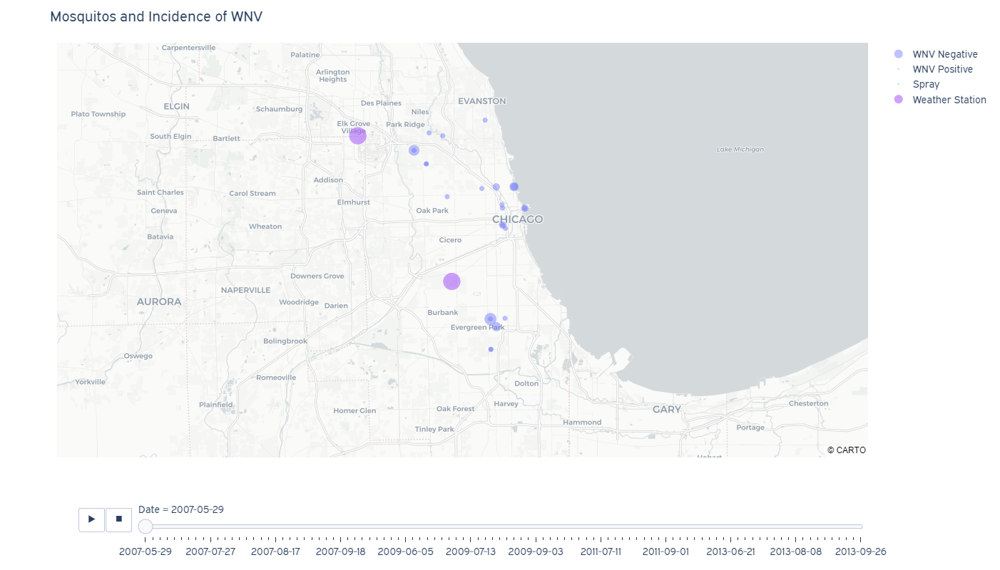

In [37]:
# Visualize the number of mosquitos and the incidence of WNV. 
figure = make_scatter_mapbox(train, spray, include_stations=True)
figure.update_layout(mapbox={"center": {"lat": center(train["Latitude"]), 
                                        "lon": center(train["Longitude"])}, 
                             "zoom": 9}, 
                     title="Mosquitos and Incidence of WNV")
figure.show()

#### Descriptions:

- The colors denote what each area represents:
    - blue : trap with WNV negative (not present)
    - red : trap with WNV positive (present)
    - green : sprayed area
    - purple : weather station (1 or 2) 
- The sizes of the dots represent the number of mosquitos found on each trap.

#### Notes:
- The sizes of spray and weather stations do not represent anything.

### Effect of Sprays

In [38]:
# Set a time range to examine before and after each spray.
delta = pd.Timedelta("30 days")

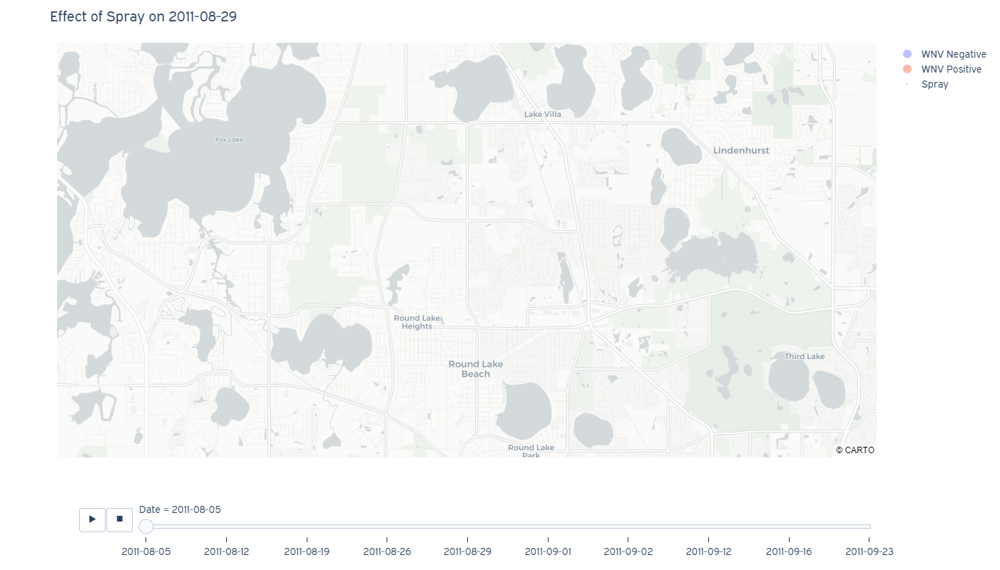

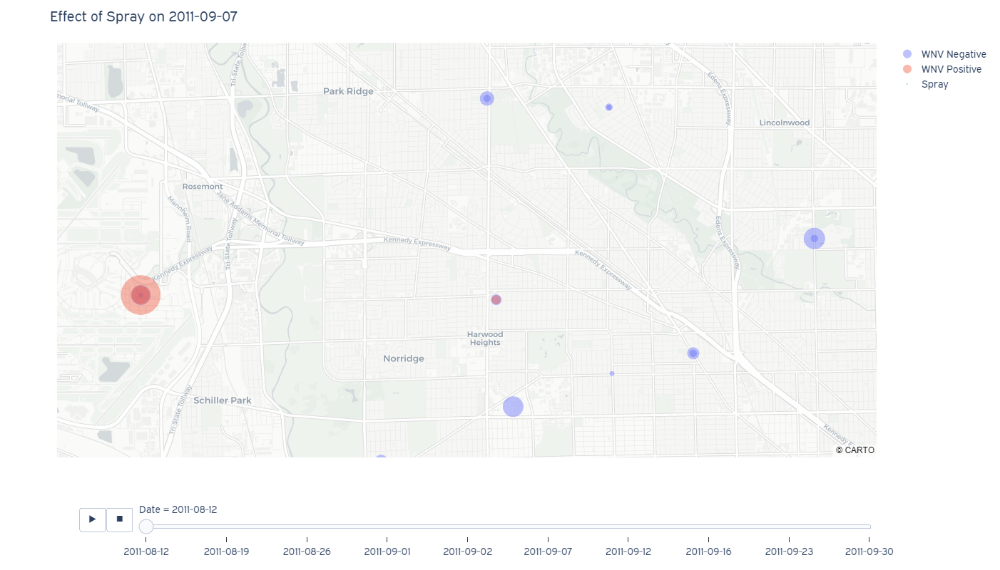

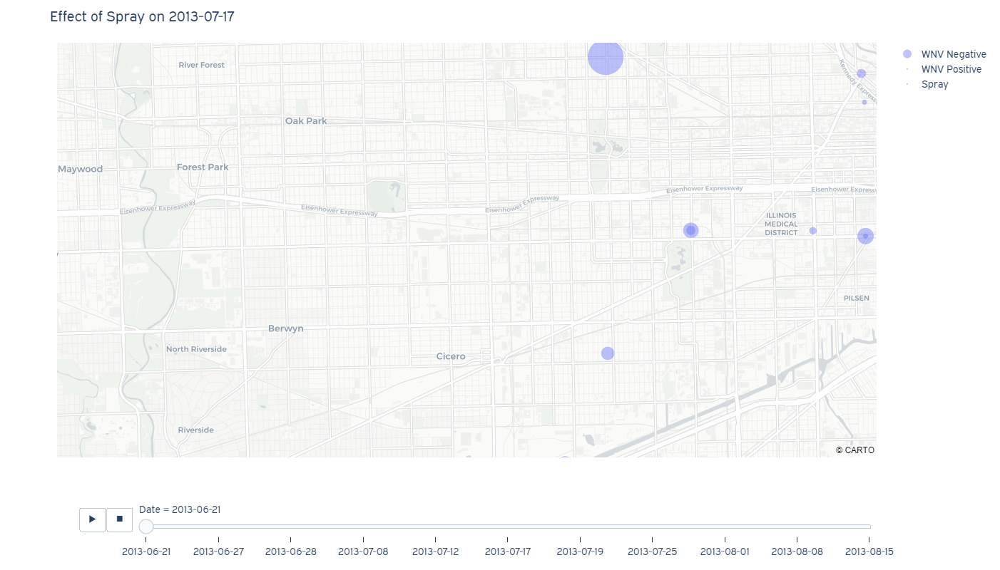

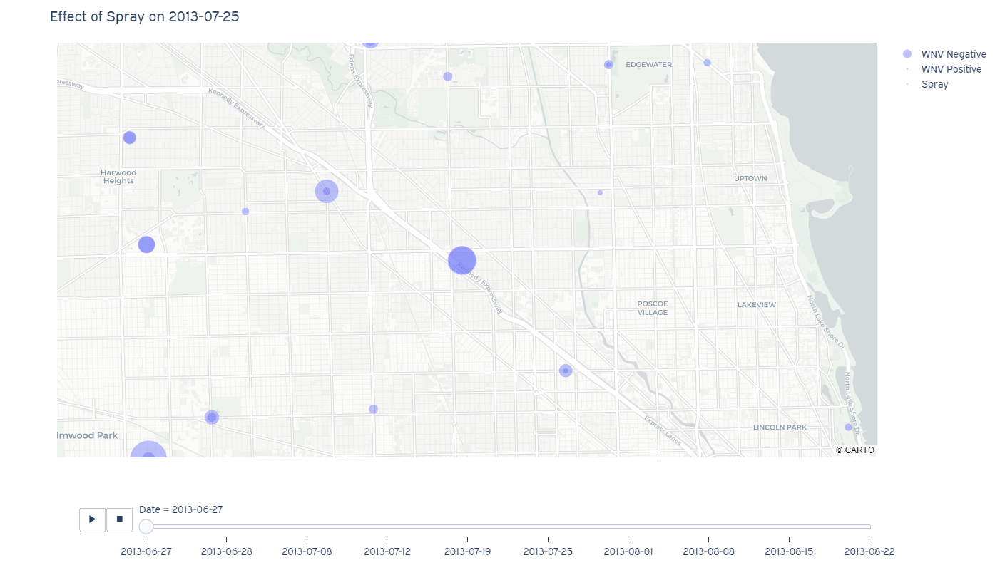

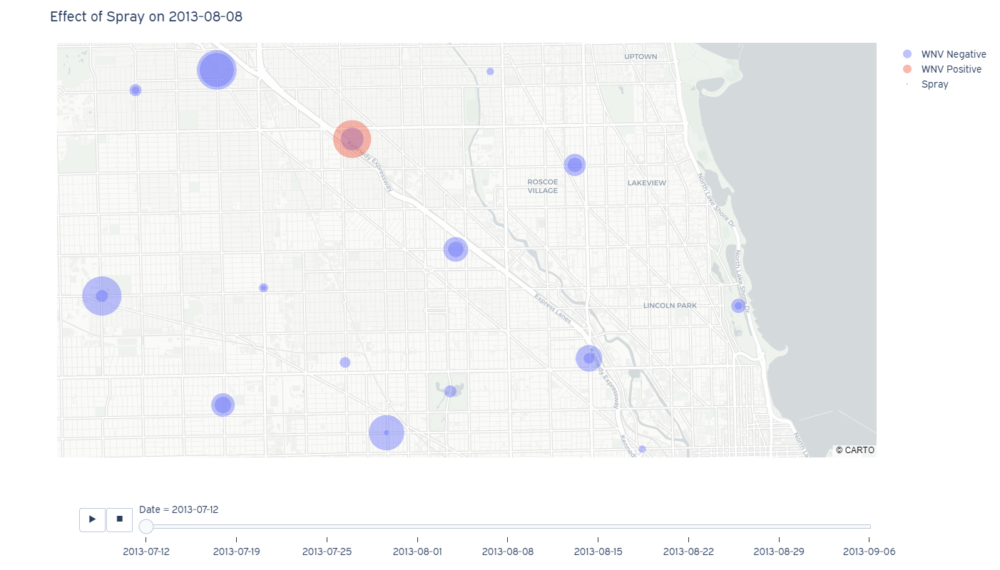

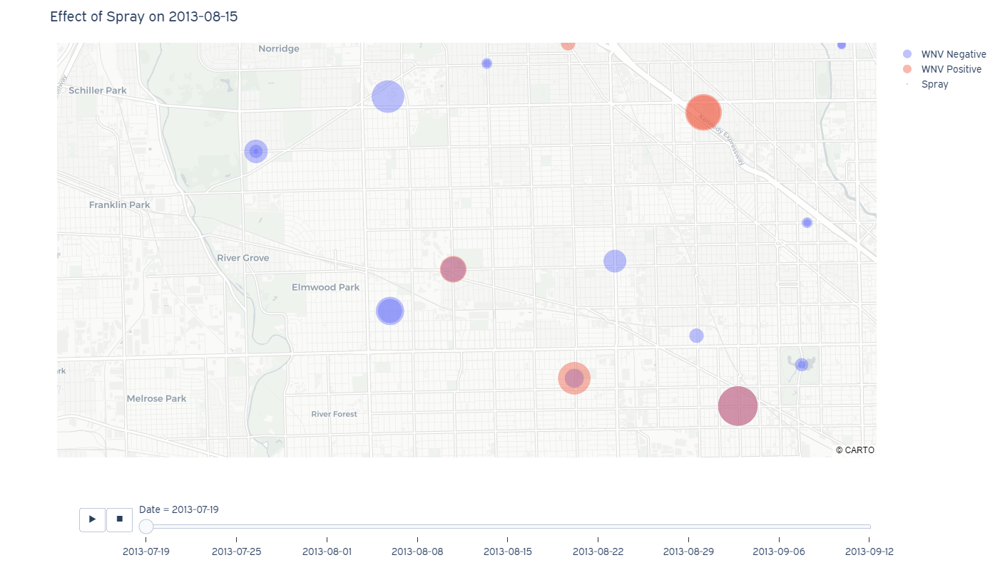

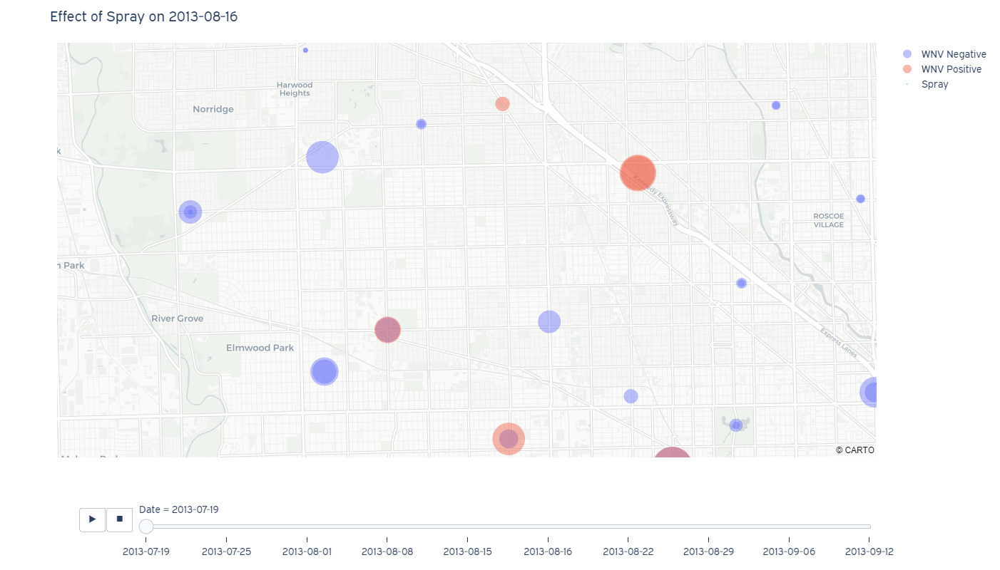

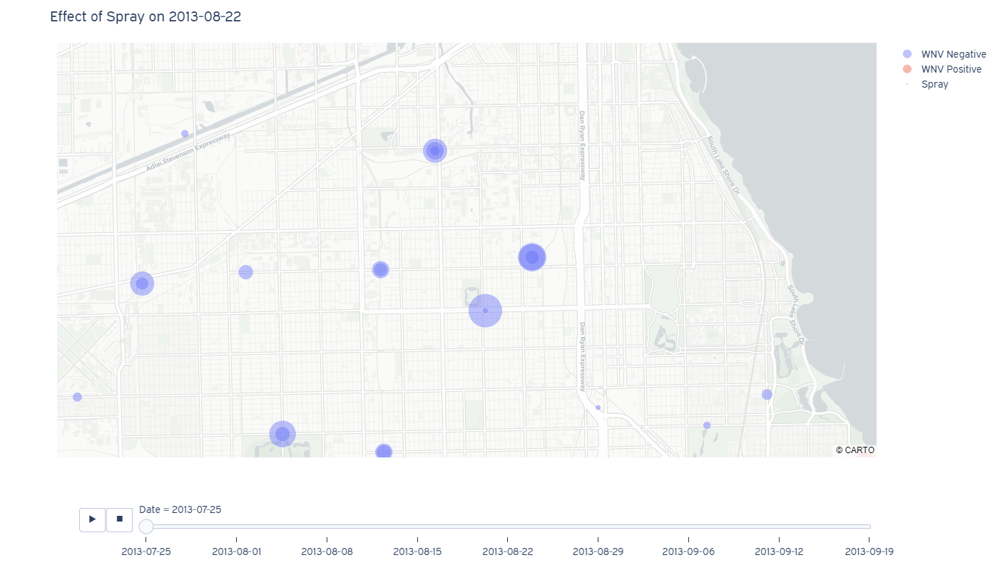

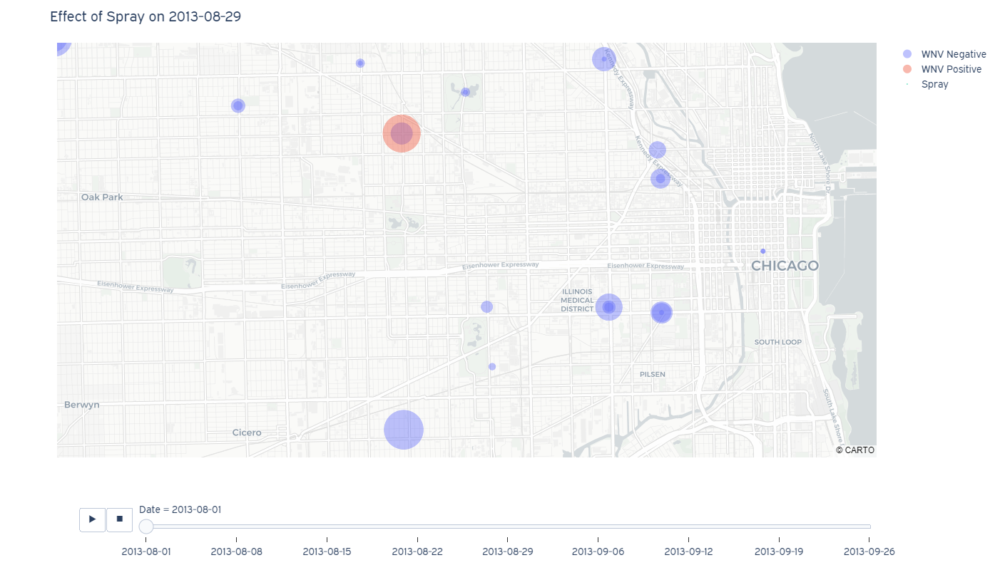

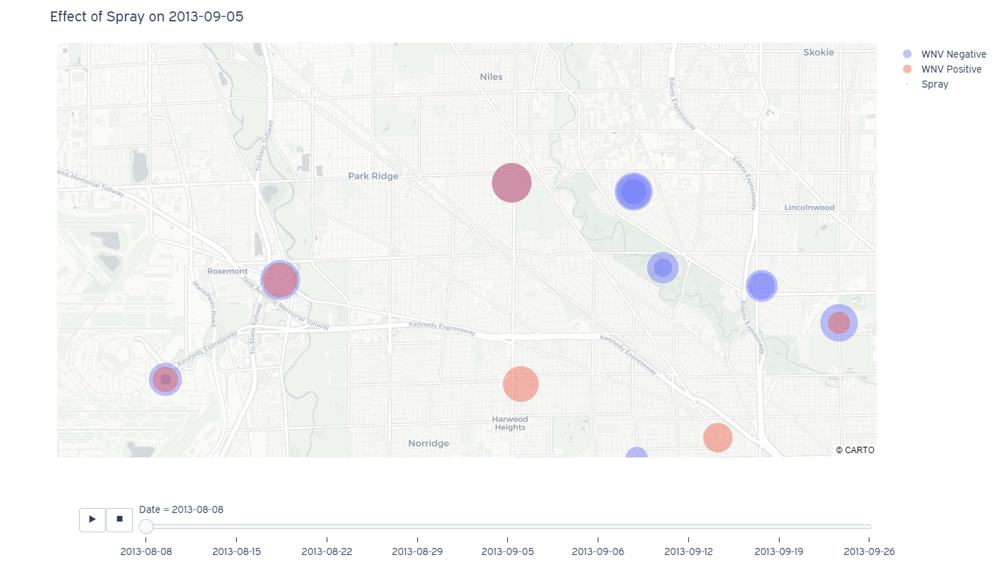

In [39]:
# Visualize the effect of sprays.
for date in spray["Date"].unique():
    spray_involved = spray[spray["Date"] == date]
    figure = make_scatter_mapbox(train[train["Date"].between(date-delta, date+delta)], 
                                 spray_involved)
    figure.update_layout(mapbox={"center": {"lat": center(spray_involved["Latitude"]),
                                            "lon": center(spray_involved["Longitude"])}, 
                                 "zoom": 12},
                         title="Effect of Spray on " + np.datetime_as_string(date, unit="D"))
    figure.show()

#### Descriptions:

- The colors denote what each area represents:
    - blue : trap with WNV negative (not present)
    - red : trap with WNV positive (present)
    - green : sprayed area
- The sizes of the dots represent the number of mosquitos found on each trap.

#### Notes:
- The first spray location is very distant from the available traps. Its effect cannot be studied.
- The sizes of spray do not represent anything.

#### Findings:

- The locations of spray are quite off from our traps. I am not sure if this is intentional.
- It is quite hard to tell if spray is effective in killing the mosquitos.
- The number of mosquitoes found after sprayed is sure to be less, but we can observe this similar trend in other unsprayed areas as well.
- Most of the time, WNV-positive traps change to WNV-negative after sprayed. However, the effect does not last long. WNV sometimes returns 14 days - 1 month later.